## Graphene/BN stack diffusion simulation

### Potential Surface

First we define the potential energy surface described for a graphene/hBN stack as described by the section **Parametrization of potential energy** of *Origin of band gaps in graphene on hexagonal boron nitride* (Jung et. al.)

Potential can be written as (eq. 28):

$$\Phi(x, y, C_0, C_1, \phi) = C_0 + 2C_1 \cos(\phi-G_1y) + 4C_1 \cos(G_1y/2 + \phi)\cos(\sqrt{3}G_1x / 2)$$

In [10]:
import numpy as np
import matplotlib.pyplot as plt

lattice_constant_mismatch = 0.03
lattice_angle_mismtach = 0 * np.pi / 180 # degrees to radians
# Moire superlattice wavelength, in units of graphene lattice constant length
# lm = (lattice_constant_mismatch ** 2 + lattice_angle_mismtach ** 2) ** (-1/2)
lm = 45
G1 = 4 * np.pi / (np.sqrt(3) * lm)
# G1 = 2e-1

f1 = lambda x, y, C1, phi: 2 * C1 * np.cos(phi - G1 * y) \
    + 4 * C1 * np.cos(G1 * y/2 + phi) * np.cos(np.sqrt(3)*G1 * x /2)

def Phi(C0, C1, phi):
    """
    Returns a function U(x, y) that evaluates to Phi(x, y; C0, C1, phi)
    Lattice constant defaults to graphene lattice constant in nanometers (nm)
    """
    return lambda x, y : C0 + f1(x, y, C1, phi)

# Define constants
M0, tau, D0, T0, T1, phi = 0.06975, 7, 3.46, -10.44, -58.87, 50.4 / 180 * np.pi
M = lambda x : -M0 * (1 + tau * x) * np.exp(-tau * x)
T = lambda x : T0 / (x ** 4 + T1)
W = lambda x : (1 + np.exp(-16 * (x - 4))) ** -1
C0 = lambda z : (M(z / D0 - 1) + (T(z) - M(z / D0 - 1)) * W(z))
z = 3.4 # Angstroms
C0 = C0(z)

a, b, z0  = 2.226, 3.295, 1.295
z = 3.4 # Angstroms
C1 = lambda z : a * np.exp(-b * (z - z0))
C1 = C1(z)

Uc = Phi(C0 / 2, C1, phi)
print("Moire lattice constant lm = {}".format(lm))
print("Moire reciprocaal lattice constant G1 = {}".format(G1))

Moire lattice constant lm = 45
Moire reciprocaal lattice constant G1 = 0.16122661015415268


<a list of 70 text.Text objects>

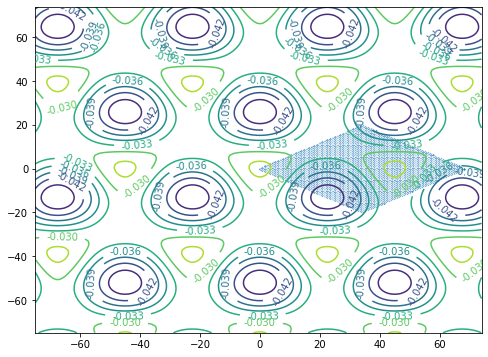

In [18]:
import seaborn as sns
lattice = []
atom_a = np.array([0, 0])
atom_b = np.array([1/np.sqrt(3), 0])
a1 = np.array([np.sqrt(3)/2, 1/2])
a2 = np.array([np.sqrt(3)/2, -1/2])
for i in range(40):
    for j in range(40):
        cell_origin = i * a1 + j * a2
        lattice.append(cell_origin + atom_a)
        lattice.append(cell_origin + atom_b)
lattice = np.array(lattice)
plt.figure(figsize=(8, 6))
ax = sns.scatterplot(lattice[:,0], lattice[:, 1], s=10)
delta = 1
x = np.arange(-75, 75, delta)
y = np.arange(-75, 75, delta)
X, Y = np.meshgrid(x, y)
Z = Uc(X, Y)
CS = ax.contour(X, Y, Z)
ax.clabel(CS, inline=1, fontsize=10)

In [12]:
from scipy.interpolate import interp1d
import pandas as pd
def simulate(N=250, num_jumps=10000, temperature=2e-1, end_time=100, num_pts=None, abs_temp=None):
    """
    Return dataframe of trajectories with
        N : number of independent single particles
        num_jumps : number of Monte Carlo steps
        end_time : last point in lab-time, wait times are rescaled to fit in this time frame
        num_pts : number of evenly spaced points in time for the actual trajectory
    """
    U_max = Uc(0, 0)
    U_min = Uc(0, -lm * 2 / np.sqrt(3))
    r = lambda theta : np.array(( (np.cos(theta), -np.sin(theta)),
                   (np.sin(theta),  np.cos(theta)) ))
    U = lambda r : U_max - Uc(r[:, :, 0], r[:, :, 1])
    deg = lambda degrees : degrees / 180 * np.pi
    T = (U_max - U_min) * temperature if abs_temp is None else abs_temp # Temperature
    AB = np.array([1/np.sqrt(3), 0])

    a_transition = np.array([
        AB,
        r(deg(120)) @ AB,
        r(deg(240)) @ AB
    ], dtype=np.float64)
    b_transition = - a_transition

    # Randomly distribute N particles
    initial_positions = np.random.randint(-10, 10, size=(2, N)) # Choose lattice sites
#     initial_positions = np.zeros((2, N))
    x = initial_positions[0, :] * a1[0] + initial_positions[1, :] * a2[0]
    y = initial_positions[0, :] * a1[1] + initial_positions[1, :] * a2[1]
    initial_positions = np.array([x, y])
    tracks = np.empty((N, num_jumps + 1, 2))
    tracks[:, 0, :] = initial_positions.T
    a_neighbors = np.random.randint(3, size=(N, num_jumps // 2))
    b_neighbors = np.random.randint(3, size=(N, num_jumps // 2))
    a_jumps, b_jumps = a_transition[a_neighbors, :], b_transition[b_neighbors, :]
    jumps = np.empty((N, num_jumps, 2))
    jumps[:, ::2, :] = a_jumps
    jumps[:, 1::2, :] = b_jumps
    tracks[:, 1:, :] = jumps
    tracks = np.cumsum(tracks, axis=1)
    escape_rate = np.exp(-U(tracks) / T)
    wait_times = np.empty((N, num_jumps + 1))
    wait_times[:, 0] = np.zeros((N))
    wait_times[:, 1:] = np.random.exponential(1 / escape_rate)[:, :-1]

    num_pts = 2 * num_jumps if num_pts is None else num_pts
    tX = np.cumsum(wait_times, axis=1)
    tX_normed = tX / np.linalg.norm(tX, np.inf, axis=1)[:, np.newaxis] * end_time
#     tX_normed = tX comment out if you don't want time normalized tracks
#     tOut = np.arange(0, num_pts + 1, 1) * end_time / num_pts  # use this line if you want experiment time
    tOut = np.arange(0, num_pts + 1, 1, dtype=np.uint8) # frame number
    real_space_tracks = np.empty(shape=(N, num_pts + 1, 2))
    for particle in range(N):
        for i in [0, 1]:
            real_space_tracks[particle, :, i] = interp1d(tX_normed[particle, :], tracks[particle, :, i], 
                                                 kind='next', 
                                                 bounds_error=False)(tOut)
    
    df = pd.DataFrame()
    r_squared = (real_space_tracks[:, :, 0] - real_space_tracks[:,np.newaxis, 0, 0]) ** 2 + (real_space_tracks[:, :, 1] - real_space_tracks[:, np.newaxis, 0, 1]) ** 2
    for particle in range(N):
        tmp = pd.DataFrame(real_space_tracks[particle], columns=['x', 'y'])
        tmp['particle'] = particle
        tmp['frame'] = tOut
        tmp['r^2'] = r_squared[particle, :]
        df = pd.concat([df, tmp])
    return df

### Run all cells above to get the simulation boilerplate to work

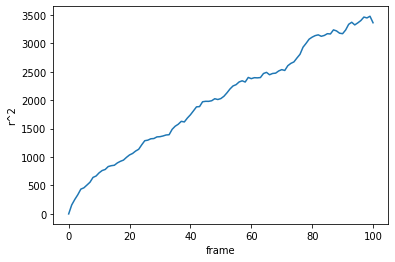

In [13]:
import seaborn as sns
# sns.lineplot(x='time', y='r^2', hue='particle', data=df, alpha=0.1)
df = simulate(N=100, num_jumps=10000)
sns.lineplot(x='frame', y='r^2', data=df.groupby('frame').mean().reset_index())

In [14]:
temp = 2e-1
df = simulate(N=300, num_jumps=10000, temperature=temp, end_time=300, num_pts=50)

In [9]:
## code for saving tracks to out files
temperatures = np.linspace(1e-2, 5e-1, 20)
for temp in temperatures:
    df = simulate(N=300, num_jumps=2000000, temperature=temp, end_time=300, num_pts=50)
    df = df[df.x.notna()]
    x = np.vstack(df.groupby(df.particle).x.apply(np.array))[:,1:]
    y = np.vstack(df.groupby(df.particle).y.apply(np.array))[:,1:]
    with open(f'sim_results/len50temp{temp}_1m.npy', 'wb') as f:
        np.save(f, x)
        np.save(f, y)
    with open(f'sim_results/len50temp{temp}_1m.npy', 'rb') as f:
        a = np.load(f)
        b = np.load(f)
    print(a.shape, b.shape)

MemoryError: Unable to allocate 8.94 GiB for an array with shape (300, 2000000, 2) and data type float64

In [131]:
tp.emsd(df, 1, 1)

Exception: Cannot use msd_gaps, more than one trajectory per particle found.

In [126]:
import trackpy as tp
tp.emsd(df, 1, 1)

Exception: Cannot use msd_gaps, more than one trajectory per particle found.

## Save traj to .mat

In [40]:
"""
Generate data file for Vida
"""
temperatures = np.linspace(1e-2, 5e-1, 20)
traj = []
for i, temp in enumerate(temperatures, start=1):
    df = simulate(N=1, num_jumps=50000, temperature=temp, end_time=300, num_pts=299)
    df.particle = i
    traj.append(df[['x', 'y', 'particle']].to_numpy())
traj = np.concatenate(traj)
mdic = {"traj": traj}
from scipy.io import savemat
savemat("matlab_matrix.mat", mdic)

In [44]:
y_full = np.array([
 [5.75418289e-07, 1.01230948e-05, 9.99989271e-01],
 [2.62750272e-06, 6.53580096e-06, 9.99990821e-01],
 [1.56615390e-05, 3.23652086e-04, 9.99660701e-01],
 [5.76141469e-07, 1.35569730e-04, 9.99863893e-01],
 [8.37016669e-05, 1.38531950e-03, 9.98530984e-01],
 [1.66609397e-05, 4.25591010e-04, 9.99557734e-01],
 [1.45475759e-03, 4.71350103e-02, 9.51410234e-01],
 [1.83403045e-01, 6.11944450e-02, 7.55402505e-01],
 [6.37709820e-02, 5.35151956e-02, 8.82713765e-01],
 [1.59848173e-01, 2.72321552e-01, 5.67830324e-01],
 [1.17901398e-02, 4.72790763e-01, 5.15419111e-01],
 [3.29931751e-02, 5.17424166e-01, 4.49582636e-01],
 [2.15547211e-01, 4.78767246e-01, 3.05685520e-01],
 [1.78561479e-01, 4.38148469e-01, 3.83290097e-01],
 [4.39570226e-01, 2.80141253e-01, 2.80288592e-01],
 [5.21938186e-02, 7.85940677e-01, 1.61865532e-01],
 [7.02010775e-02, 7.54725128e-01, 1.75073870e-01],
 [4.32799771e-01, 4.65342224e-01, 1.01858003e-01],
 [3.09279695e-01, 5.81364959e-01, 1.09355386e-01],
 [5.16618803e-01, 3.73874292e-01, 1.09506864e-01],
])

Text(0, 0.5, 'probability')

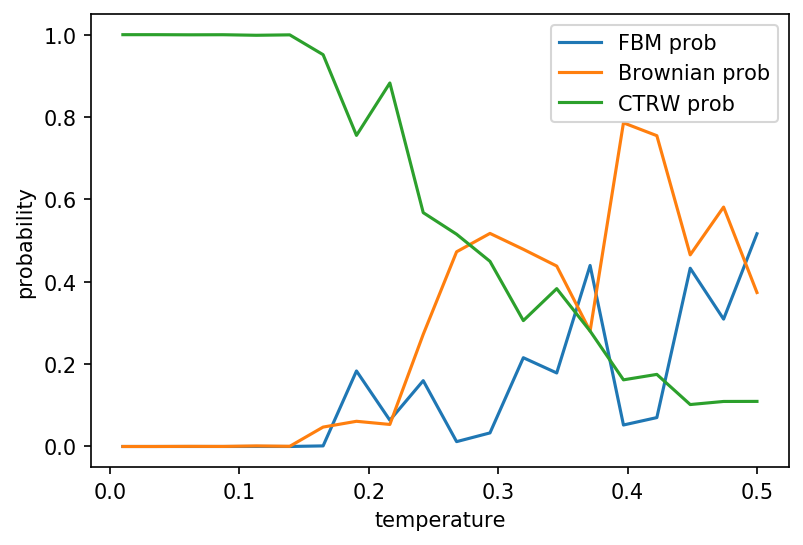

In [107]:
sns.lineplot(temperatures, y_full[:,0], label='FBM prob')
sns.lineplot(temperatures, y_full[:,1], label='Brownian prob')
sns.lineplot(temperatures, y_full[:,2], label='CTRW prob')
plt.xlabel("temperature")
plt.ylabel("probability")

## === END SAVE TO MAT =====
## === BEGIN P-VARIATION=====

In [ ]:
def pvariation(df, p, n, t=None):
    """p-variation for finite n.
    df: each trajectory data file
    p: power in p-variation formula
    n: n is the power in 2^n 
    t: max measurement time
    Frames beyond the highest power of 2 available are ignored.
    All intervals are constructed to be of equal length. T is assumed,
    without loss of generality, to equal the total number of frames included.
    
    """
    maxn = int(np.log2(len(df)) // 1)
    T = 2**maxn
    if t is None:
        t = T
    x = np.array(df['x'])
    y = np.array(df['y'])
    dt = T // 2**n
    ts = np.arange(2**n)*dt
    ts = ts[ts < t]  # Ignore frames greater than t
    total = 0.
    for i in range(len(ts) - 1):
        total += np.abs(x[ts[i+1]] - x[ts[i]])**p
    return total

In [ ]:
for j in [4, 5, 6]:
    v_t = []
    for i in range(2 ** 6):
        v_t.append(pvariation(df, 2, j, t=i))
    plt.plot(v_t, label="n = {}".format(j))
plt.legend()
plt.title('P-variation {} - {}'.format(BASE_FILENAME.format(n_range[0]), n_range[-1]))

## === END PVARIATION ====== 

In [ ]:
df

In [ ]:
sns.scatterplot(x='x', y='y', data=df[df.particle < 2])
plt.contour(X, Y, Z)

In [16]:
from scipy.stats import linregress
from joblib import Parallel, delayed
from datetime import datetime, time

def generate_slope(**kwargs):
    df = simulate(**kwargs)
    tmp = df.groupby('frame').mean().reset_index().iloc[:]
    t, r_squared = tmp['frame'], tmp['r^2']
    r_squared = np.log(r_squared[1:-1]).replace([np.inf, -np.inf], np.nan).dropna()
    slope, intercept, _, _, _ = linregress(np.log(r_squared.index)[:], r_squared[:])
    return slope

now = datetime.now()
temperatures = np.linspace(1e-2, 5e-1, 20)
expos = []
raws = []
for i, temp in enumerate(temperatures, start=1):
    slopes = Parallel(n_jobs=8)(
                delayed(generate_slope)(N=100, num_jumps=20000, temperature=temp, end_time=100, num_pts=1000) for i in range(32)
            )
    expos.append(np.mean(slopes))
    raws.append(slopes)
diff = datetime.now() - now
print (diff.seconds)

156


Text(0, 0.5, 'Diffusion exponent ')

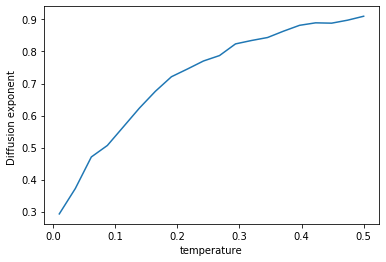

In [17]:
plt.plot(temperatures, expos)
plt.xlabel('temperature')
plt.ylabel('Diffusion exponent ')

(0.2526179413594281, 0.24428499931293343, 0.2609508834059228)

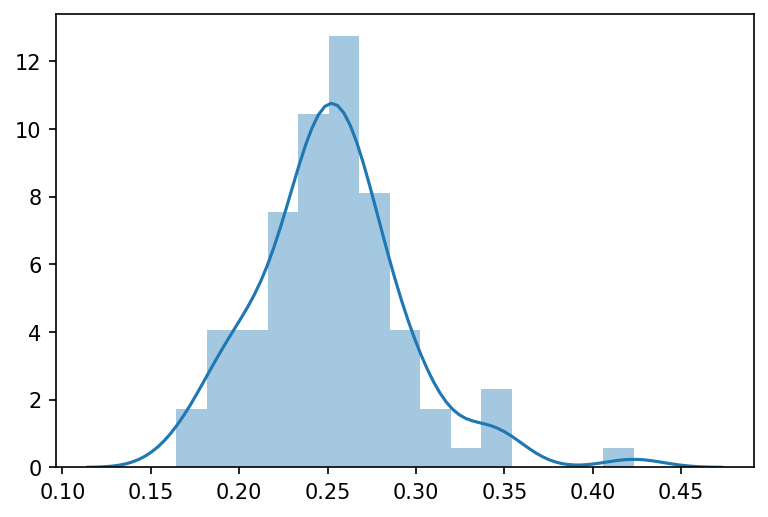

In [96]:
sns.distplot(slopes)
import scipy
def mean_confidence_interval(data, confidence=0.95):
    a = 1.0 * np.array(data)
    n = len(a)
    m, se = np.mean(a), scipy.stats.sem(a)
    h = se * scipy.stats.t.ppf((1 + confidence) / 2., n-1)
    return m, m-h, m+h
mean_confidence_interval(slopes)

In [ ]:
# jointplot = sns.jointplot(x='x', y='y', data=df, kind='hex', color='k',
#                          joint_kws = {'gridsize' : (300, 300)})
# x = np.arange(-100, 100, delta)
# y = np.arange(-100, 100, delta)
# X, Y = np.meshgrid(x, y)
# Z = Uc(X, Y)
# CS = jointplot.ax_joint.contour(X, Y, Z, alpha=0.2)
# jointplot.ax_joint.figure.set_size_inches(8, 8)
# jointplot.ax_joint.figure.set_dpi(200)
# jointplot.ax_joint.set_xlim(-100, 100)
# jointplot.ax_joint.set_ylim(-100, 100)

In [ ]:
# from scipy.stats import expon, pareto
# from scipy.special import erfcx
# ax = sns.distplot(wait_times.ravel()[:50000], fit=expon, kde=False, norm_hist=True)
# sns.distplot(wait_times.ravel(), fit=expon, kde=False, ax=ax, norm_hist=True)
# ax.set_yscale('log')
# ax.set_xscale('log')
# x = np.linspace(0.01, 2e5, 1000)
# y = 2 * x ** -2
# plt.plot(x, y)

In [ ]:
pareto.fit(wait_times.ravel()[wait_times.ravel() > 200])

Moire pattern size, moire potential height, temperature

In [ ]:
NUM_MOIRE = 10
temps = np.linspace(1e-2, 5e-1, 10)
moire_period = np.linspace(1, 55, NUM_MOIRE)
temps, moire_period = np.meshgrid(temps, moire_period)
slopes = np.empty(temps.shape)
uncertainties = np.empty(temps.shape)
now = datetime.now()
for i in range(slopes.shape[0]):
    print(i)
    for j in range(slopes.shape[1]):
        lm = moire_period[i, j]
        G1 = 4 * np.pi / (np.sqrt(3) * lm)
        runs = Parallel(n_jobs=8)(
            delayed(generate_slope)(N=250, num_jumps=10000, temperature=temps[i, j], end_time=100, num_pts=1000) for _ in range(32)
        )
        slopes[i, j] = np.mean(runs)
        uncertainties[i, j] = np.std(runs)
diff = datetime.now() - now
print (diff.seconds)

In [ ]:
fig, ax = plt.subplots()
CS = ax.contour(temps, moire_period, slopes)
ax.clabel(CS, inline=1, fontsize=10)
ax.set_xlabel('temperature')
ax.set_ylabel('moire period')

In [ ]:
import matplotlib.pylab as pl
a = 0.246 # graphene lattice constant in angstrom
colors = pl.cm.jet(np.linspace(0,1,NUM_MOIRE))
for i in range(0, NUM_MOIRE, 2):
    plt.plot(temps[i] * 150, slopes[i], '-o',
                 label='{0:.2f} nm'.format(moire_period[i, 0] * a),
                 color=colors[i])
plt.xlabel('Temperature (K)')
plt.ylabel('Exponent')
plt.legend(title='Moire Period')
plt.title('Diffusion Exponent vs. Temperature and Moire Size')

In [ ]:
C1 = 0.001
Uc = Phi(C0 / 2, C1, phi)
print(Uc(0, 0))
print(Uc(0, -lm * 2 / np.sqrt(3)))

In [ ]:
3 / 0.24

In [ ]:
NUM_MOIRE = 5
abs_temps = np.linspace(1e-4, 5e-3, 20)
moire_amplitudes = np.linspace(1e-2, 5e-2, NUM_MOIRE)
abs_temps, moire_amplitudes = np.meshgrid(abs_temps, moire_amplitudes)
slopes = np.empty(abs_temps.shape)
uncertainties = np.empty(abs_temps.shape)
now = datetime.now()
for i in range(slopes.shape[0]):
    print(i)
    for j in range(slopes.shape[1]):
        lm = 45
        G1 = 4 * np.pi / (np.sqrt(3) * lm)
        C1 = moire_amplitudes[i, j]
        Uc = Phi(C0 / 2, C1, phi)
        U_delta = Uc(0, 0) - Uc(0, lm * 2 / np.sqrt(3))
        moire_amplitudes[i, j] = U_delta
        runs = Parallel(n_jobs=8)(
            delayed(generate_slope)(N=700, num_jumps=10000, temperature=None, end_time=100, num_pts=1000, abs_temp=abs_temps[i, j]) for _ in range(128)
        )
        slopes[i, j] = np.mean(runs)
        uncertainties[i, j] = np.std(runs)
diff = datetime.now() - now
print (diff.seconds)

In [ ]:
import matplotlib.pylab as pl
plt.figure(figsize=(8,6))
colors = pl.cm.jet(np.linspace(0,1,NUM_MOIRE)) 
for i in range(0, NUM_MOIRE):
    plt.plot(abs_temps[i] * 200 / 1000 * 1.16e4 , slopes[i], '-o',
                 label="{0:2.0f} meV".format(moire_amplitudes[i, 0] * 200),
                 color=colors[i])
plt.xlabel('Temperature (K)')
plt.ylabel('Exponent')
plt.legend(title='Moire Corrugation Energy')
plt.title('Diffusion Exponent vs. Temperature and Moire Corrugation Energy')

In [13]:
NUM_TRAJ = 25
NUM_PTS = 100
df = simulate(N=NUM_TRAJ, num_jumps=10000, temperature=2e-1, end_time=100, num_pts=NUM_PTS)
df.head()

,x,y,particle,time,r^2
0,1.732051,-5.0,0,0.0,0.0
1,16.454483,8.5,0,1.0,399.0
2,17.320508,-1.0,0,2.0,259.0
3,20.784610,-7.0,0,3.0,367.0
4,21.650635,-6.5,0,4.0,399.0


Animation size has reached 21093686 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


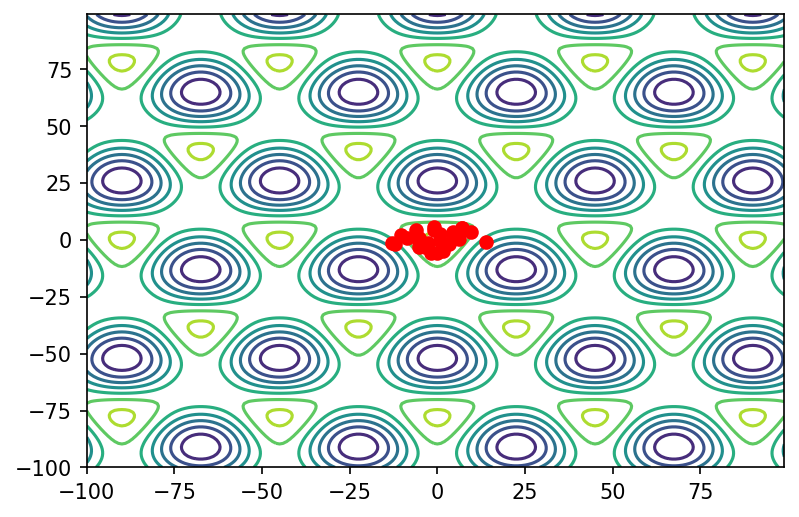

In [14]:
import matplotlib.animation
import matplotlib.pyplot as plt
import numpy as np
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()
trajs = df[['x', 'y']].to_numpy().reshape(NUM_TRAJ, NUM_PTS+1, 2)
def animate(i):
    plt.cla()
    plt.plot(trajs[:,i, 0].T, trajs[:,i, 1].T, 'ro') ## There are leeway in avoiding these costly transpositions
#             plt.plot(trajs[:,:i+1, 0].T, trajs[:,:i+1, 1].T)
    x = np.arange(-100, 100, 1)
    y = np.arange(-100, 100, 1)
    X, Y = np.meshgrid(x, y)
    Z = Uc(X, Y)
    CS = plt.contour(X, Y, Z)
# Set up formatting for the movie files
Writer = matplotlib.animation.writers['ffmpeg']
writer = Writer(fps=5, metadata=dict(artist='Me'), bitrate=1800)
line_ani = matplotlib.animation.FuncAnimation(fig, animate, frames=100)
line_ani

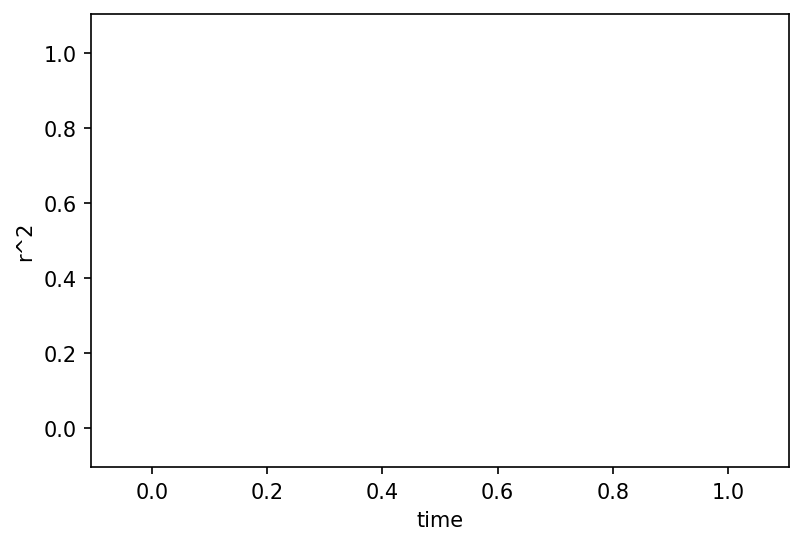

In [23]:
fig, ax = plt.subplots()
def animate(i):
    plt.cla()
    tmp = df[df.time < i]
    sns.lineplot(x='time', y='r^2', data=tmp, alpha=0.1)
    sns.lineplot(x='time', y='r^2', data=tmp.groupby('time').mean().reset_index(), label='MSD')
my_anim = matplotlib.animation.FuncAnimation(fig, animate, frames=100)

In [ ]:
np.random.seed(0)
sub_df = simulate(N=1000, num_jumps=10000, temperature=4e-1, end_time=10000, num_pts=100,)
brown_df = simulate(N=1000, num_jumps=10000, temperature=1e3, end_time=10000, num_pts=100,)

In [ ]:
sns.lineplot(x='time', y='r^2', data=sub_df, alpha=1, label='subdiffusive', ci=0)
sns.lineplot(x='time', y='r^2', data=brown_df, alpha=1, label='normal diffusivity', ci=0)